### > Call Initial Modules

In [5]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns

### > Bring in Data

In [7]:
# ------------------------------------------------------------------
# Step 1: Load Excel data into DataFrame & prep binary label
# ------------------------------------------------------------------

import pandas as pd

pd.set_option('display.max_columns', None)

file_path = "./Interview_Task.xlsx"
sheet_name = "DATA"

df = pd.read_excel(file_path, sheet_name=sheet_name)

# df = df.head(1000)

if 'label' in df.columns:
    df['label'] = df['label'].map({False: 0, True: 1})

#len(df)
#print(df.iloc[0].T) 
##print(df.head(50))

print(df.columns.tolist()) # Print the list of column names to confirm all columns have been loaded


['index', 'age', 'C0', 'C1', 'C2', 'C3', 'C4', 'CA1', 'CA2', 'CA3', 'CA4', 'CA5', 'CA6', 'CA7', 'CA8', 'CA9', 'date', 'duration', 'E1', 'F1', 'GE', 'G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'PF', 'PT', 'FEE', 'SC0', 'SC1', 'U1', 'V0', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'label']


### > Investigate data types, missing and unique values for dataset

Assumption:
- Most label values show false - 
- the assumption is that true means cancelled otherwise there would only be a 10% retention rate of clients for this year of data

In [11]:
# ------------------------------------------------------------------
# Step 1: Define summary generator function for data exploration
# ------------------------------------------------------------------

def generate_column_summary(df, sample_limit=5):
    total_rows = df.shape[0]
    
    summary = pd.DataFrame({
        "Data Type": df.dtypes,                                           # column data types
        "Min": df.describe().loc["min"],                                  # min values (numeric only)
        "Max": df.describe().loc["max"],                                  # max values (numeric only)
        "Missing": df.isnull().sum(),                                     # number of missing values
        "% Missing": (df.isnull().sum() / total_rows * 100).round(2),     # % of missing values
        "Unique": df.nunique(),                                           # count of unique values
        "Sample Value": df.apply(lambda x: x.dropna().unique()[:sample_limit])  # sample values
    })

    print(f"\nDataFrame Shape: {df.shape[0]} rows × {df.shape[1]} columns\n")
    
    return summary

# ------------------------------------------------------------------
# Step 2: Generate column-level summary for initial inspection
# ------------------------------------------------------------------

summary_df = generate_column_summary(df)

# ------------------------------------------------------------------
# Step 3: Display summary table to screen
# ------------------------------------------------------------------

display(summary_df)



DataFrame Shape: 50000 rows × 51 columns



,Data Type,Min,Max,Missing,% Missing,Unique,Sample Value
C0,int64,0.0,1.0,0,0.00,2,"[0, 1]"
C1,int64,0.0,1.0,0,0.00,2,"[0, 1]"
C2,int64,0.0,1.0,0,0.00,2,"[0, 1]"
C3,int64,0.0,1.0,0,0.00,2,"[0, 1]"
C4,float64,0.0,216.378276,40486,80.97,3598,"[22.4526898665522, 0.0, 28.244380921786, 68.67..."
CA1,int64,0.0,0.0,0,0.00,1,[0]
CA2,int64,0.0,1.0,0,0.00,2,"[0, 1]"
CA3,float64,0.0,0.0,35975,71.95,1,[0.0]
CA4,float64,0.0,5.0,6483,12.97,6,"[0.0, 1.0, 2.0, 3.0, 4.0]"
CA5,float64,0.0,1.0,22711,45.42,2,"[0.0, 1.0]"


Notes:
- Noted negative ages and durations
- 50,000 records, only 41,710 unique, showing duplicates - will require further investigation to decide how to handle multiple records associated with same index
- Noted multiple columns with missing values 
- Duration units = years
- CA1, CA3, CA8 have only one value - will not assist with model prediction, will drop columns

### > Geographic Investigation: G7-G9 look like co-ordinates

Why:

- Certaing G columns looked like they may be co-ordinates, I wanted to plot the permutations to see if there was a geographic pattern
- I plotted the label against the co-ordinates to see if perhaps there was an area density (under the assumtion tht these are transformed co-ordinates) to see if a potential pattern could be detected
- This was investigated as if there were to be a pattern, it could be incorporated into the proposed marketing strategy from a geographic perspective

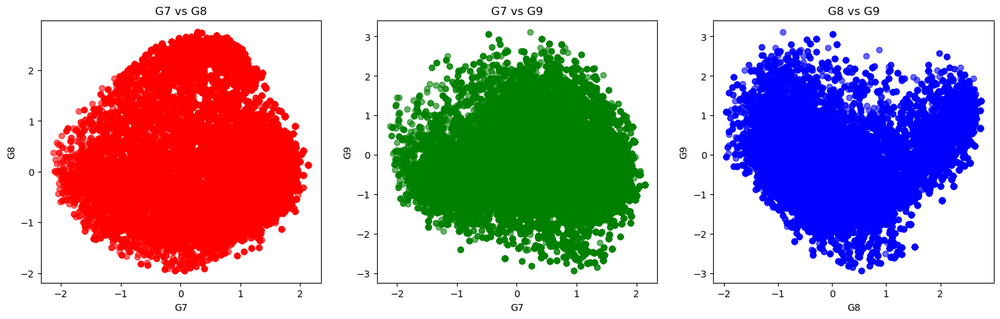

In [15]:
# ------------------------------------------------------------------
# Step 1: Create subplots layout (1 row, 3 columns) for scatter plots
# ------------------------------------------------------------------

fig, axs = plt.subplots(1, 3, figsize=(18, 5)) 

# ------------------------------------------------------------------
# Step 2: Scatterplot of G7 vs G8 — explore direct relationship
# ------------------------------------------------------------------

axs[0].scatter(df['G7'], df['G8'], color='red', alpha=0.6) 
axs[0].set_xlabel('G7')
axs[0].set_ylabel('G8')
axs[0].set_title('G7 vs G8')

# ------------------------------------------------------------------
# Step 3: Scatterplot of G7 vs G9 — check potential pattern or outliers
# ------------------------------------------------------------------

axs[1].scatter(df['G7'], df['G9'], color='green', alpha=0.6) 
axs[1].set_xlabel('G7')
axs[1].set_ylabel('G9')
axs[1].set_title('G7 vs G9')

# ------------------------------------------------------------------
# Step 4: Scatterplot of G8 vs G9 — analyze correlation or clusters
# ------------------------------------------------------------------

axs[2].scatter(df['G8'], df['G9'], color='blue', alpha=0.6) 
axs[2].set_xlabel('G8')
axs[2].set_ylabel('G9')
axs[2].set_title('G8 vs G9')

# ------------------------------------------------------------------
# Step 5: Adjust spacing and display all three scatter plots
# ------------------------------------------------------------------

plt.show()


In [16]:
# Likely co-ordinates
# Likely standardized or PCA used to center on 0

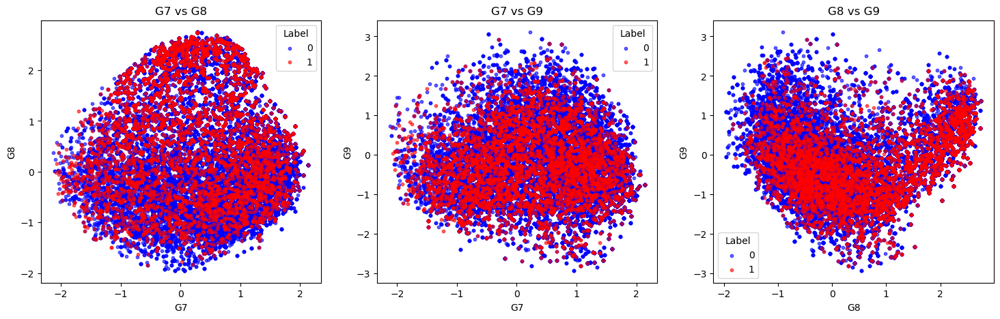

In [17]:
# ------------------------------------------------------------------
# Step 1: Import additional modules
# ------------------------------------------------------------------

#from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as mpatches

# ------------------------------------------------------------------
# Step 2: Set up color mapping for binary labels and extract label values
# ------------------------------------------------------------------

label_colors = {True: 'red', False: 'blue'}  
labels = df['label'].unique()

# ------------------------------------------------------------------
# Step 3: Create subplots layout for 2D scatter comparisons
# ------------------------------------------------------------------

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

# ------------------------------------------------------------------
# Step 4: Plot G7 vs G8, split by label color to investigate any patterns for policy churn
# ------------------------------------------------------------------
for label in labels:
    subset = df[df['label'] == label]
    axs[0].scatter(subset['G7'], subset['G8'], 
                   label=str(label), 
                   color=label_colors[label], 
                   alpha=0.6,
                   s=10)
axs[0].set_xlabel('G7')
axs[0].set_ylabel('G8')
axs[0].set_title('G7 vs G8')
axs[0].legend(title='Label')

# ------------------------------------------------------------------
# Step 5: Plot G7 vs G9, split by label color to investigate any patterns for policy churn
# ------------------------------------------------------------------

for label in labels:
    subset = df[df['label'] == label]
    axs[1].scatter(subset['G7'], subset['G9'], 
                   label=str(label), 
                   color=label_colors[label], 
                   alpha=0.6,
                   s=10)
axs[1].set_xlabel('G7')
axs[1].set_ylabel('G9')
axs[1].set_title('G7 vs G9')
axs[1].legend(title='Label')

# ------------------------------------------------------------------
# Step 6: Plot G8 vs G9, split by label color to investigate any patterns for policy churn
# ------------------------------------------------------------------

for label in labels:
    subset = df[df['label'] == label]
    axs[2].scatter(subset['G8'], subset['G9'], 
                   label=str(label), 
                   color=label_colors[label], 
                   alpha=0.6,
                   s=10)
axs[2].set_xlabel('G8')
axs[2].set_ylabel('G9')
axs[2].set_title('G8 vs G9')
axs[2].legend(title='Label')

# ------------------------------------------------------------------
# Step 7: Show visuals
# ------------------------------------------------------------------

plt.show()

##################################################################################################################33

# ------------------------------------------------------------------
# Step 8: (Optional) 3D scatterplot setup for visualizing G7, G8, G9 by label - seeing if there are 3D co-ordinate systems
# ------------------------------------------------------------------
#fig = plt.figure(figsize=(12, 9))  
#ax = fig.add_subplot(111, projection='3d')
#scatter = ax.scatter(df['G7'], df['G8'], df['G9'], c=df['label'].astype(int), cmap='coolwarm', alpha=0.6, s=10)
#legend_labels = df['label'].unique()
#legend_colors = ['blue', 'red']  
#handles = [mpatches.Patch(color=color, label=str(label)) for label, color in zip(legend_labels, legend_colors)]
#ax.legend(handles=handles, title='Label', loc='upper right')
#ax.set_xlabel('G7')
#ax.set_ylabel('G8')
#ax.set_zlabel('G9')
#ax.set_title('3D Plot of G7, G8, G9 by Label')

#plt.show()



### > Age vs Policy Cancellation Investigation

Why:
- This visual analysis could give quick insights that could form part of a useful strategy in recommendations concerning the marketing strategy
- Age is likely a factor involved in the cancellation metric 
- The plot assists with quick visual inspections concerning skewness which will give a quick indication of whether transformations are required if it is a feature

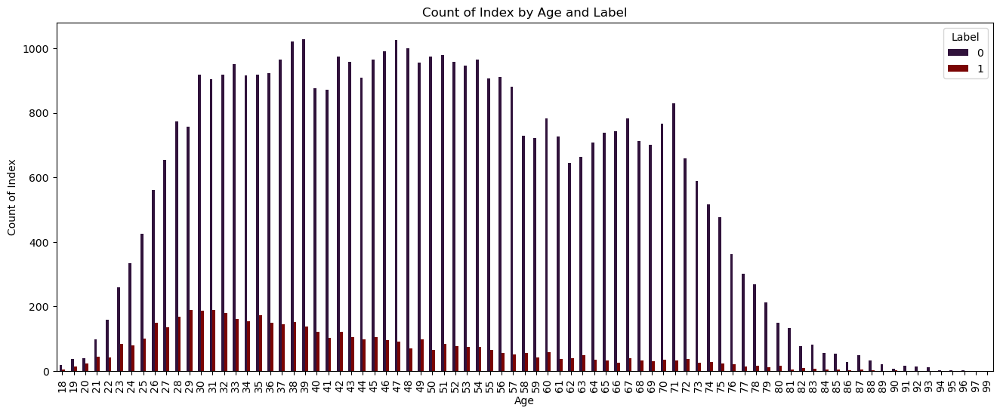

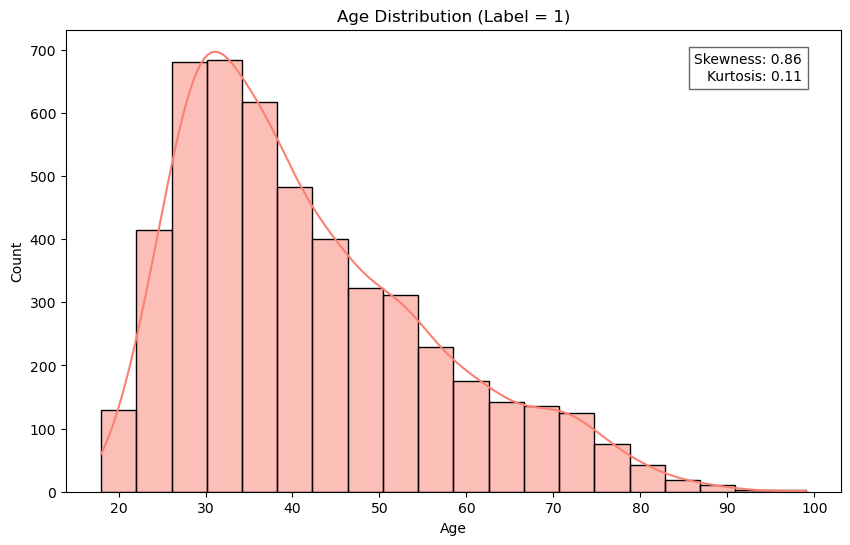

In [20]:
from scipy.stats import kurtosis, skew

# ------------------------------------------------------------------
# Step 1: Filter valid age range [0, 100] and count index by age & label
# ------------------------------------------------------------------
df_age_filter = df[(df['age'] >= 0) & (df['age'] <= 100)]  # Filter out -ve age rows and ages >100
age_label_counts = df_age_filter.groupby(['age', 'label'])['index'].count().unstack(fill_value=0)

# Plot count of records by age, separated by label (not stacked)
# Note: Each bar represents a unique age value
age_label_counts.plot(kind='bar', stacked=False, figsize=(16, 6), colormap='turbo')

plt.xlabel('Age')
plt.ylabel('Count of Index')
plt.title('Count of Index by Age and Label')
plt.legend(title='Label')
plt.show()

####################################################################################################################

# ------------------------------------------------------------------
# Step 2: Filter rows with label=1 and valid age range for distribution plot
# ------------------------------------------------------------------

df_label_1 = df[(df['label'] == 1) & (df['age'] >= 0) & (df['age'] <= 100)]
age_values = df_label_1['age'].dropna()

# ------------------------------------------------------------------
# Step 3: Calculate skewness and kurtosis for age distribution
# ------------------------------------------------------------------
kurt = kurtosis(age_values)
skw = skew(age_values)

# ------------------------------------------------------------------
# Step 4: Histogram + KDE of age for label=1
# - Bins: 20 age groups (bin size ~5 years if uniformly distributed)
# - KDE: smoothed density estimate over histogram
# ------------------------------------------------------------------
plt.figure(figsize=(10, 6))
sns.histplot(age_values, kde=True, bins=20, color='salmon', edgecolor='black')

plt.title('Age Distribution (Label = 1)')
plt.xlabel('Age')
plt.ylabel('Count')

# ------------------------------------------------------------------
# Step 5: Annotate plot with skewness and kurtosis values
# ------------------------------------------------------------------
plt.text(0.95, 0.95, f'Skewness: {skw:.2f}\nKurtosis: {kurt:.2f}',
         transform=plt.gca().transAxes,
         ha='right', va='top', bbox=dict(facecolor='white', alpha=0.6))

plt.show()


- The skewness is not extreme but depending on model, may need to transform or standardize/scale if model is sensitive to feature distribution
- Marketing strategy should target agegroups 26-42 predominantly (mainly 30-39)

### > Duration vs Policy Cancellation Investigation

Why:
- This visual analysis could give quick insights that could form part of a useful strategy in recommendations concerning the marketing strategy
- Duration is likely a factor involved in the cancellation metric 
- The plot assists with quick visual inspections concerning skewness which will give a quick indication of whether transformations are required if it is a feature

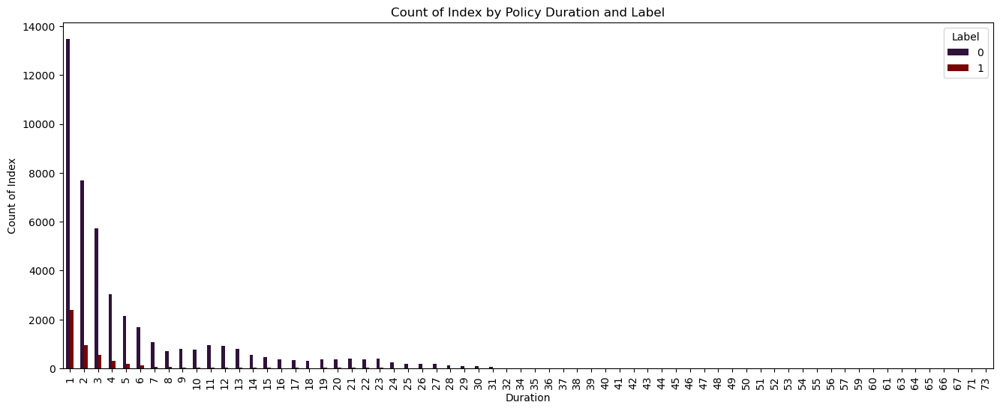

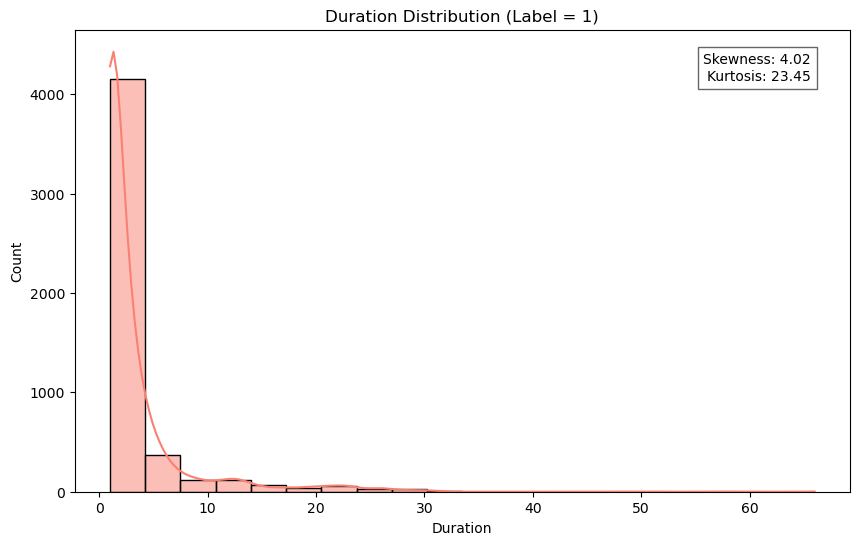

In [24]:
# ------------------------------------------------------------------
# Step 1: Filter out negative duration values
# ------------------------------------------------------------------
df_durat_filter = df[(df['duration'] >= 0)]  # Filter out -ve duration

# ------------------------------------------------------------------
# Step 2: Group by policy duration and label, count occurrences
# ------------------------------------------------------------------
age_label_counts = df_durat_filter.groupby(['duration', 'label'])['index'].count().unstack(fill_value=0)

# ------------------------------------------------------------------
# Step 3: Plot count of records by duration, separated by label
# - Kind: bar chart
# - Stacked: False (side-by-side bars)
# - Colormap: 'turbo' for color variation
# ------------------------------------------------------------------
age_label_counts.plot(kind='bar', stacked=False, figsize=(16, 6), colormap='turbo')

plt.xlabel('Duration')
plt.ylabel('Count of Index')
plt.title('Count of Index by Policy Duration and Label')
plt.legend(title='Label')
#plt.tight_layout()  # Optional: Uncomment to fix any axis/label overlap
plt.show()

####################################################################################################################

# ------------------------------------------------------------------
# Step 4: Filter rows with label = 1 and valid duration for distribution
# ------------------------------------------------------------------
df_label_2 = df[(df['label'] == 1) & (df['duration'] >= 0)]
durat_values = df_label_2['duration'].dropna()

# ------------------------------------------------------------------
# Step 5: Calculate skewness and kurtosis for policy duration
# ------------------------------------------------------------------
kurt1 = kurtosis(durat_values)
skw1 = skew(durat_values)

# ------------------------------------------------------------------
# Step 6: Plot histogram and KDE for duration distribution (label = 1)
# - Bins: 20 → finer granularity for distribution shape
# - KDE: density estimate overlay
# ------------------------------------------------------------------
plt.figure(figsize=(10, 6))
sns.histplot(durat_values, kde=True, bins=20, color='salmon', edgecolor='black')

plt.title('Duration Distribution (Label = 1)')
plt.xlabel('Duration')
plt.ylabel('Count')

# ------------------------------------------------------------------
# Step 7: Display skewness and kurtosis in plot annotations
# ------------------------------------------------------------------
plt.text(0.95, 0.95, f'Skewness: {skw1:.2f}\nKurtosis: {kurt1:.2f}',
         transform=plt.gca().transAxes,
         ha='right', va='top', bbox=dict(facecolor='white', alpha=0.6))

plt.show()


Notes:
- duration vs cancellation data is highly right skewed - no large outliers
- will likely need to transform to use in the model (log/root transformation should work)
- might need to cap or winsorize extreme value (but no real extreme outliers so likely unnecessary)
- if using tree/rule based logic may require binning duration feature

### > Investigate duplicate rows - why there are multiple records for the same Index

In [17]:
# ------------------------------------------------------------------
# Step 1: Add row number per group based on 'index' key
# ------------------------------------------------------------------
df['rn'] = df.groupby('index').cumcount() + 1

# ------------------------------------------------------------------
# Step 2: Identify keys (index values) that appear 2 or more times
# ------------------------------------------------------------------
duplicate_keys = df['index'].value_counts()[lambda x: x >= 2].index  # show values where index key appears more than once

# ------------------------------------------------------------------
# Step 3: Filter dataset for only the first and second records of duplicate keys
# ------------------------------------------------------------------
df_dups = df[(df['index'].isin(duplicate_keys)) & (df['rn'].isin([1, 2]))]

# ------------------------------------------------------------------
# Step 4: Sort by index and row number for clear visual comparison
# ------------------------------------------------------------------
df_dups = df_dups.sort_values(by=['index', 'rn'])

# ------------------------------------------------------------------
# Step 5: Display full result 
# ------------------------------------------------------------------
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(df_dups)


,index,age,C0,C1,C2,C3,C4,CA1,CA2,CA3,CA4,CA5,CA6,CA7,CA8,CA9,date,duration,E1,F1,GE,G1,G2,G3,G4,G5,G6,G7,G8,G9,PF,PT,FEE,SC0,SC1,U1,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,label,rn
10,#0it7DIfvo,80,0,0,0,0,NaN,0,0,NaN,2.0,NaN,NaN,NaN,NaN,1,2018-09-01,46,0,3,0,0.0,4.0,4.0,26.0,3.04,3.96,1.469190,0.499690,0.298419,0,0,22.386315,7,0,1,NaN,0,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1
11,#0it7DIfvo,80,0,0,0,0,NaN,0,0,NaN,2.0,NaN,NaN,NaN,NaN,1,2018-10-01,46,0,3,0,0.0,4.0,4.0,26.0,3.04,3.96,1.469190,0.499690,0.298419,0,0,22.386315,7,0,1,NaN,0,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,2
13,#0nyGtFwFT,79,0,0,0,0,NaN,0,1,0.0,3.0,NaN,NaN,NaN,NaN,1,2019-05-01,2,1,0,1,0.0,4.0,4.0,35.0,1.55,4.92,-0.183492,-0.691680,1.481207,0,0,24.349471,8,1,1,NaN,0,NaN,NaN,NaN,0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1
14,#0nyGtFwFT,78,0,0,0,0,NaN,0,1,0.0,3.0,NaN,NaN,NaN,NaN,1,2018-09-01,1,1,0,1,0.0,4.0,4.0,35.0,1.55,4.92,-0.183492,-0.691680,1.481207,0,0,23.352542,8,1,1,NaN,0,NaN,NaN,NaN,0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,2
17,#1M4BvMQQa,33,0,0,0,0,NaN,0,1,NaN,1.0,0.0,0.0,NaN,NaN,1,2019-01-01,2,1,0,0,0.0,0.0,4.0,23.0,4.27,2.51,1.382679,1.215699,-2.439039,0,0,19.001047,10,1,1,0.0,1,NaN,3.0,1439.0,0,1,0.0,NaN,301.0,1.0,37.0,5.0,NaN,0,1
18,#1M4BvMQQa,33,0,0,0,0,NaN,0,1,NaN,1.0,0.0,0.0,NaN,NaN,1,2018-10-01,2,1,0,0,0.0,0.0,4.0,23.0,4.27,2.51,1.382679,1.215699,-2.439039,0,0,19.001047,10,1,1,0.0,1,275.0,3.0,931.0,0,1,0.0,NaN,277.0,0.0,24.0,4.0,1.0,0,2
22,#1yHF@X2Z3,32,0,0,0,0,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2019-04-01,1,0,3,0,5.0,2.0,NaN,NaN,3.33,1.69,-0.852713,0.794101,-0.721438,0,0,8.250296,0,0,2,0.0,0,NaN,2.0,505.0,0,1,20.0,19.0,69.0,43.0,NaN,NaN,NaN,0,1
23,#1yHF@X2Z3,32,0,0,0,0,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0,2019-05-01,1,0,3,0,5.0,2.0,NaN,NaN,3.33,1.69,-0.852713,0.794101,-0.721438,0,0,8.250296,0,0,2,0.0,1,NaN,2.0,798.0,0,1,31.0,1.0,76.0,2.0,1.0,6.0,NaN,0,2
29,#2EoUkvzv#,53,0,0,0,0,NaN,0,1,0.0,0.0,0.0,NaN,NaN,NaN,0,2018-07-01,2,1,0,1,0.0,6.0,4.0,13.0,1.25,15.67,0.258797,-0.231611,-0.408669,0,0,13.034611,16,1,0,NaN,0,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,1
30,#2EoUkvzv#,53,0,0,0,0,NaN,0,1,0.0,0.0,0.0,NaN,NaN,NaN,0,2018-08-01,2,1,0,1,0.0,6.0,4.0,13.0,1.25,15.67,0.258797,-0.231611,-0.408669,0,0,13.034611,16,1,0,NaN,0,NaN,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,2


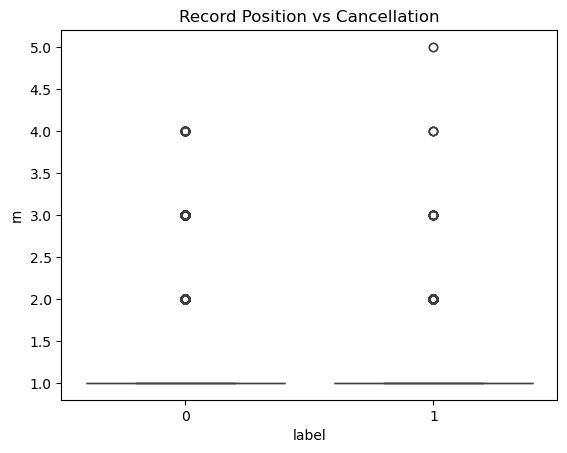

In [18]:
sns.boxplot(x='label', y='rn', data=df) # Check correlation between rn and label
plt.title("Record Position vs Cancellation")
plt.show()

### > Feature-Target Association Tests

#### Point Biserial Correlation

Why:

- Measure the strength and direction of association between a binary target (like label = 0 or 1) and a continuous feature.
- Identify which numeric features have a meaningful relationship with the classification outcome.
- Filter out weak predictors early in your feature selection process.
- Quick, interpretable statistical test to gauge feature relevance before modeling.

In [21]:
# ------------------------------------------------------------------
# Step 1: Import point-biserial correlation function
# ------------------------------------------------------------------
from scipy.stats import pointbiserialr

# ------------------------------------------------------------------
# Step 2: Define target variable and select numeric features (excluding the target)
# ------------------------------------------------------------------
target = 'label'                              
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns.drop(target, errors='ignore')

# ------------------------------------------------------------------
# Step 3: Initialize empty list to store correlation results
# ------------------------------------------------------------------
pb_results = []

# ------------------------------------------------------------------
# Step 4: Loop through each numeric column to compute point-biserial correlation
# - Drop rows with NaNs in either column
# - Ensure the target is binary before calculating
# ------------------------------------------------------------------
for col in numeric_cols:
    
    valid = df[[col, target]].dropna()
    if valid[target].nunique() == 2:           # ensure target is binary
        r, p = pointbiserialr(valid[col], valid[target])
        pb_results.append({'Feature': col, 'r_pb': r, 'p_value': p})

# ------------------------------------------------------------------
# Step 5: Create a DataFrame of results and sort by absolute correlation strength
# ------------------------------------------------------------------
pb_df = pd.DataFrame(pb_results).sort_values('r_pb', key=abs, ascending=False)

# ------------------------------------------------------------------
# Step 6: Display final correlation table
# ------------------------------------------------------------------
display(pb_df)

C:\Users\Natasha.Derrick\AppData\Local\anaconda3\Lib\site-packages\scipy\stats\_stats_py.py:5535: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  rpb, prob = pearsonr(x, y)
C:\Users\Natasha.Derrick\AppData\Local\anaconda3\Lib\site-packages\scipy\stats\_stats_py.py:5535: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  rpb, prob = pearsonr(x, y)
C:\Users\Natasha.Derrick\AppData\Local\anaconda3\Lib\site-packages\scipy\stats\_stats_py.py:5535: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  rpb, prob = pearsonr(x, y)


,Feature,r_pb,p_value
34,V0,0.383057,0.000000e+00
0,age,-0.152682,1.889566e-258
46,V12,0.108831,1.105174e-27
25,G7,-0.102672,1.169333e-116
15,duration,-0.099479,3.784502e-110
42,V8,0.098595,2.866761e-20
44,V10,0.096877,8.019180e-37
45,V11,-0.095936,7.580615e-22
5,C4,-0.092992,1.000337e-19
38,V4,-0.091529,4.534967e-45


Notes:
- V0 r = 0.38 - clear linear signal, good for linear or logistic model, fine for any model
- age, V12, G7, duration, V8, V10, V11 - weak/moderate linear relationship
- others have weak linear influence/non-linear - fine for tree based models

### > EDA - Label Column Investigation

Label Distribution:
        Label  Count
0  Retain (0)  45000
1  Cancel (1)   5000

 Percentage Distribution:
label
0    90.0
1    10.0
Name: proportion, dtype: float64


C:\Users\Natasha.Derrick\AppData\Local\Temp\ipykernel_45772\3187586967.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=label_plot_df, x='Label', y='Count', palette='bright')


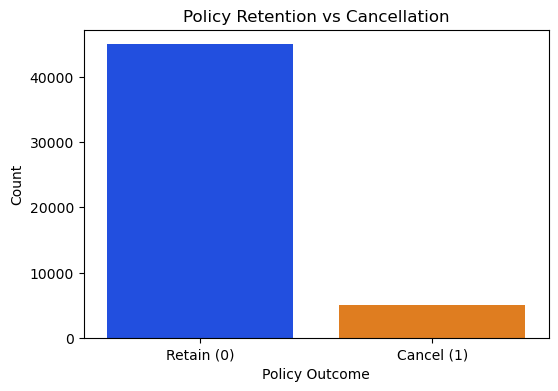

In [23]:
# ------------------------------------------------------------------
# Step 1: Count label values and prepare DataFrame for plotting
# ------------------------------------------------------------------
label_plot_df = df['label'].value_counts().rename_axis('Label').reset_index(name='Count')
label_plot_df['Label'] = label_plot_df['Label'].map({0: 'Retain (0)', 1: 'Cancel (1)'})

# ------------------------------------------------------------------
# Step 2: (Optional) Print label counts and percentages for inspection
# ------------------------------------------------------------------
# print("Label Distribution:")
# print(label_plot_df)

# label_percent = df['label'].value_counts(normalize=True) * 100
# print("\n Percentage Distribution:")
# print(label_percent.round(2))

# ------------------------------------------------------------------
# Step 3: Plot bar chart showing label distribution
# ------------------------------------------------------------------
plt.figure(figsize=(6, 4))
sns.barplot(data=label_plot_df, x='Label', y='Count', palette='bright')
plt.xlabel("Policy Outcome")
plt.ylabel("Count")
plt.title("Policy Retention vs Cancellation")
# plt.tight_layout()  # Optional: uncomment to fix layout if overlapping
plt.show()


### > Categorical Breakdown by Label - looking at value counts per label

Why: Quick visual inspection of each column in relation to the label distribution

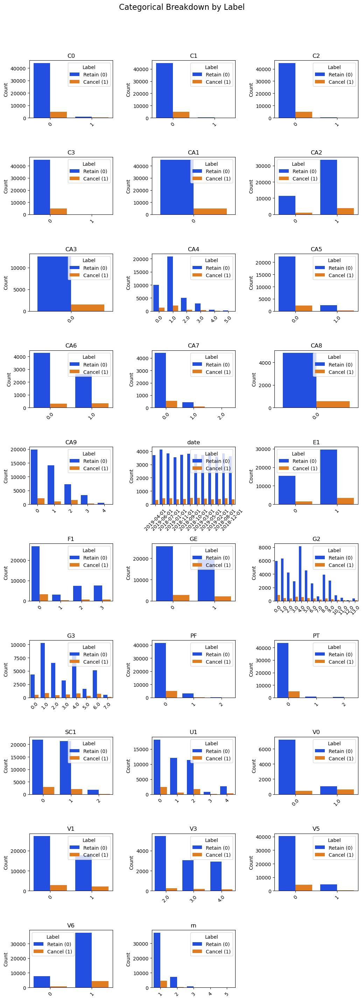

No cancellations for C3 = 1


In [25]:
# ------------------------------------------------------------------
# Step 1: Identify categorical columns with ≤15 unique values (excluding target)
# ------------------------------------------------------------------
import math as m
categorical_cols = [col for col in df.columns if df[col].nunique() <= 15 and col != 'label']

# ------------------------------------------------------------------
# Step 2: Calculate number of rows needed for subplot layout
# ------------------------------------------------------------------
n_cols = 3
n_rows = m.ceil(len(categorical_cols) / n_cols)

# ------------------------------------------------------------------
# Step 3: Create subplot grid sized to fit all categorical plots
# ------------------------------------------------------------------
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3.5, n_rows * 3))
axes = axes.flatten()  # Flatten in case of single-row/column layout

# ------------------------------------------------------------------
# Step 4: Plot count of each categorical feature by label
# ------------------------------------------------------------------
for i, col in enumerate(categorical_cols):
    sns.countplot(data=df, x=col, hue='label', palette='bright', ax=axes[i])
    axes[i].set_title(f"{col}")
    axes[i].set_xlabel("")
    axes[i].set_ylabel("Count")
    axes[i].legend(title="Label", labels=["Retain (0)", "Cancel (1)"])
    axes[i].tick_params(axis='x', rotation=45)

# ------------------------------------------------------------------
# Step 5: Remove any unused subplot axes if total plots < grid size
# ------------------------------------------------------------------
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])  # Remove unused subplots

# ------------------------------------------------------------------
# Step 6: Final formatting of figure and display
# ------------------------------------------------------------------
fig.suptitle("Categorical Breakdown by Label", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# ------------------------------------------------------------------
# Step 7: Print categories with no observed cancellations (label=1)
# ------------------------------------------------------------------
for col in categorical_cols:
    zero_cancel_vals = df[df['label'] == 0][col].value_counts().index.difference(df[df['label'] == 1][col].unique())
    for val in zero_cancel_vals:
        print(f"No cancellations for {col} = {val}")



Note:

- 1st Category Set: C0 - C3: Data shows when value is set to 1, there are near 0 cancellations.
- 2nd Category Set: CA1 only has 1 value, so inconsequential to analysis, CA2 shows a higher retention and cancellation rate when set to 1, CA3 is inconsequential, CA4 shows an increased retention and cancellation rate for [0,1], both the retention and cancellation rates decrease as the value increases between [2,5], where values of 4 and 5 show significant decreases in cancellation rates, CA5 shows lower cancellation rates when set to 1, but also has a lower retention rate, CA6 shows the same cancellation rate for both [0,1], CA8 is inconsequential, CA9 shows a decreasing retention rate as the value increases from 0–4, with a near 0 cancellation rate where CA9 = 4.
- 3rd Category Set: E1 shows both a higher retention and cancellation rate when set to 1.
- 4th Category Set: F1 shows the highest retention and cancellation rate when set to 0 but lower cancellation rates between [1,3], where the cancellation rate increases as the value increases from 1 to 3.
- 5th Category Set: GE shows very little difference between cancellation rates where GE is in [0,1].
- 6th Category Set: G2 and G3 show lowest cancellation rates at higher numeric values where min cancellation for G2 = 12 and min cancellation for G3 = 7, max retention for G2 = 4 and max retention for G3 = 1.
- 7th Category Set: PF shows a decrease in both retention and cancellation as the values increase from 0–2 with no cancellations for PF = 2. PT shows 0 cancellations where PT is in [1,2].
- 8th Category Set: SC1 shows a similar retention and cancellation pattern for values [0,1] with a significant decrease in cancellation where SC1 = 2.
- 9th Category Set: U1 shows a decrease in retention rate as U1 increases from 0–4, with a minimum cancellation where U1 = 3.
- 10th Category Set: V0 has a higher cancellation rate where V0 = 1, a similar cancellation rate for V1 for values [0,1], a decrease in cancellation rate for V3 as V3 increases from 2–4, a notable decrease in cancellation of policy when V5 = 1, and both an increased retention and cancellation rate where V6 = 1.

- Summary: Some categories definitively show binary values where cancellation is set to 0, while others show that at certain values there are both decreases in cancellation and retention simultaneously.

### > Investigate how columns correlate with label column

Why: To understand which features increase or decrease the likelihood of the target class, helping with feature selection, interpretation, and improving model interpretability.

In [27]:
# ------------------------------------------------------------------
# Step 1: Compute correlation matrix for numeric columns only
# - Extract correlation with 'label' column
# - Drop self-correlation
# - Sort in descending order
# ------------------------------------------------------------------

corr_matrix = df.corr(numeric_only=True)['label'].drop('label').sort_values(ascending=False) 

# ------------------------------------------------------------------
# Step 2: Display top 10 features positively correlated with policy cancellation
# ------------------------------------------------------------------

print("Features positively correlated with cancellation of policy:") 
print(corr_matrix.head(10), "\n")

# ------------------------------------------------------------------
# Step 3: Display bottom 10 features (negatively correlated)
# ------------------------------------------------------------------

print("Features negatively correlated with cancellation of policy:")
print(corr_matrix.tail(10))

Features positively correlated with cancellation of policy:
V0     0.383057
V12    0.108831
V8     0.098595
V10    0.096877
CA6    0.077674
V2     0.065909
CA7    0.052652
G3     0.051889
C0     0.041321
G8     0.038552
Name: label, dtype: float64 

Features negatively correlated with cancellation of policy:
G4         -0.089741
V4         -0.091529
C4         -0.092992
V11        -0.095936
duration   -0.099479
G7         -0.102672
age        -0.152682
CA1              NaN
CA3              NaN
CA8              NaN
Name: label, dtype: float64


### > Investigate Linearity for Model Considerations

Why: Assist with determinning whether to use a linear (regression) model or non-linear (tree-based) model

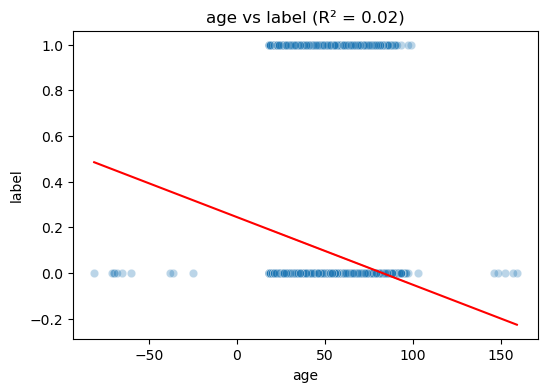

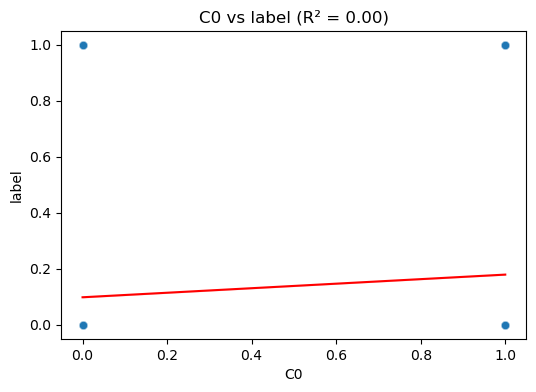

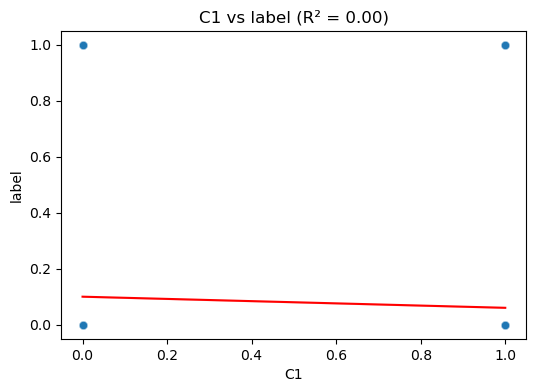

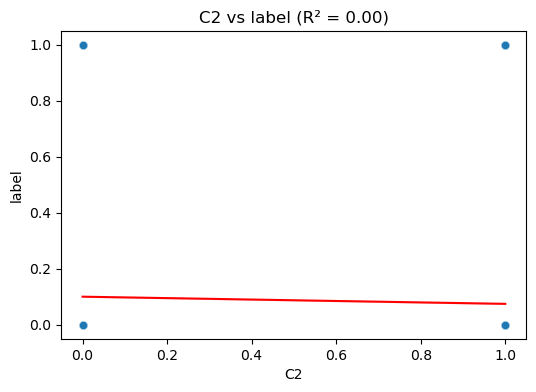

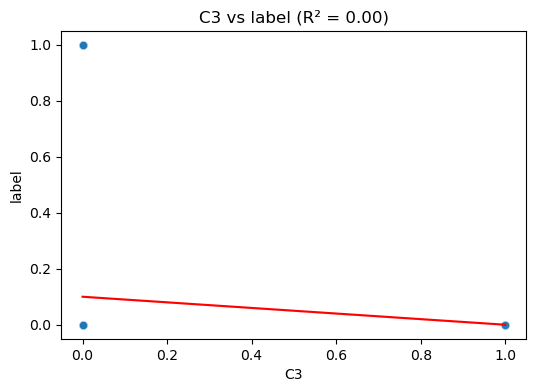

...

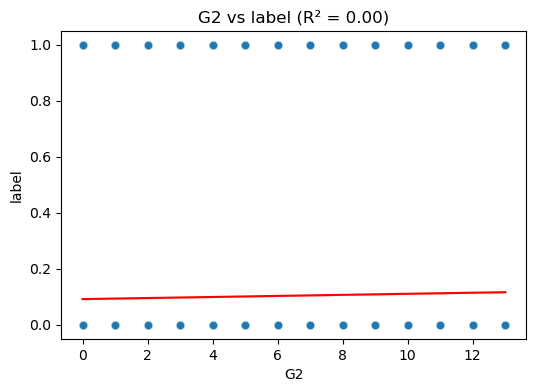

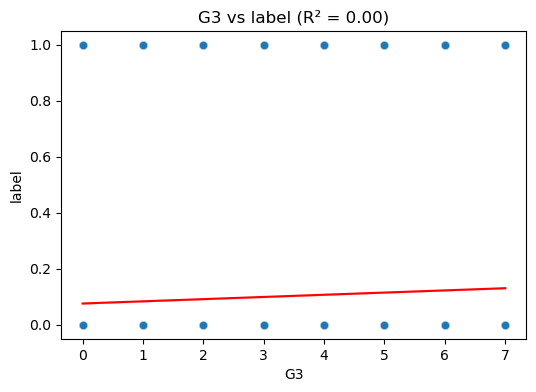

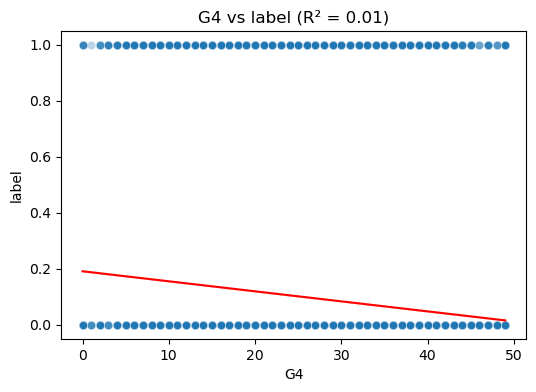

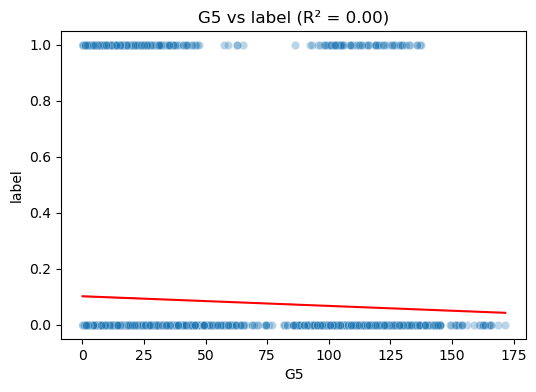

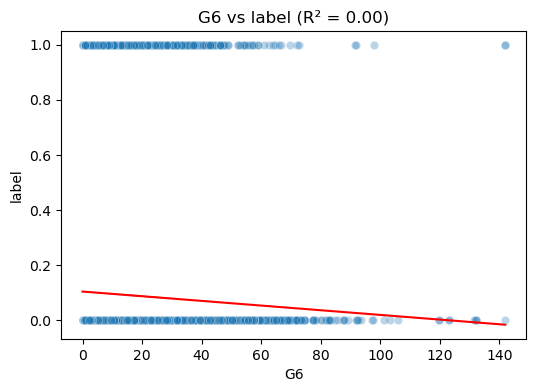

KeyboardInterrupt: 

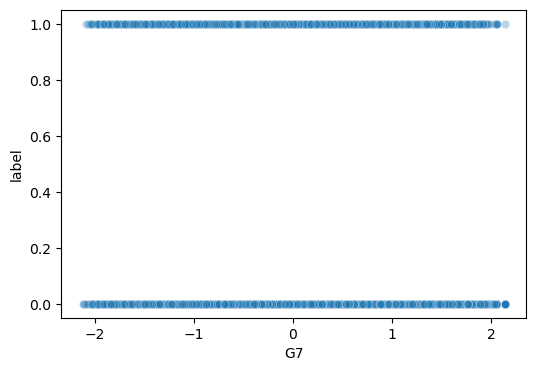

In [29]:
# ------------------------------------------------------------------
# Step 1: Import linear regression model and R² scoring function
# ------------------------------------------------------------------
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ------------------------------------------------------------------
# Step 2: Define target and extract numeric features (excluding the target)
# ------------------------------------------------------------------
target = 'label'
numeric_features = df.select_dtypes(include=['int64', 'float64']).drop(columns=[target], errors='ignore')

# ------------------------------------------------------------------
# Step 3: Initialize dictionary to store R² values for each feature
# ------------------------------------------------------------------
r2_results = {}

# ------------------------------------------------------------------
# Step 4: Loop through each numeric feature to evaluate linearity with label
# ------------------------------------------------------------------
for feature in numeric_features.columns:
    x = df[[feature]].dropna()                    # Drop NaNs in the feature
    y = df.loc[x.index, target]                   # Align target values with available feature rows

    model = LinearRegression()                    # Instantiate linear regression
    model.fit(x, y)                               # Fit model on feature vs label
    y_pred = model.predict(x)                     # Predict label using the fitted model

    r2 = r2_score(y, y_pred)                      # Compute R² score
    r2_results[feature] = r2                      # Store result

# ------------------------------------------------------------------
# Step 5: Plot scatterplot with regression line overlay
# ------------------------------------------------------------------
    plt.figure(figsize=(6, 4))
    sns.scatterplot(x=feature, y=target, data=df, alpha=0.3)
    sns.lineplot(x=x[feature], y=y_pred, color='red')
    plt.title(f'{feature} vs {target} (R² = {r2:.2f})')
    plt.show()

# ------------------------------------------------------------------
# Step 6: Print sorted R² scores to assess linearity with the target
# ------------------------------------------------------------------
print("\n R2 Scores (Linearity Measure):")
for feature, r2 in sorted(r2_results.items(), key=lambda x: -abs(x[1])):
    print(f"{feature}: {r2:.2f}")


In [31]:
# ------------------------------------------------------------------
# Step 1: Import linear regression and R² scoring function
# ------------------------------------------------------------------
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ------------------------------------------------------------------
# Step 2: Define target and R² threshold to classify linearity
# ------------------------------------------------------------------
target = 'label'  
threshold = 0.3  

# ------------------------------------------------------------------
# Step 3: Initialize list to store results for each feature
# ------------------------------------------------------------------
results = []

# ------------------------------------------------------------------
# Step 4: Loop through each numeric feature to fit linear model vs target
# ------------------------------------------------------------------
for feature in numeric_features.columns:
    x = df[[feature]].dropna()                      # Drop missing values in feature
    y = df.loc[x.index, target]                     # Align label with non-missing feature rows

    model = LinearRegression()                      # Instantiate linear regression model
    model.fit(x, y)                                 # Fit model
    y_pred = model.predict(x)                       # Predict label values

    r2 = r2_score(y, y_pred)                        # Compute R² score
    linear = int(abs(r2) >= threshold)              # Mark as linear if R² exceeds threshold
    results.append({
        'Feature': feature,
        'R2 Score': r2,
        'Linear': linear
    })

# ------------------------------------------------------------------
# Step 5: Create DataFrame of results and display sorted by R²
# ------------------------------------------------------------------
linearity_df = pd.DataFrame(results).sort_values(by='R2 Score', ascending=False)
display(linearity_df)


,Feature,R2 Score,Linear
34,V0,1.467326e-01,0
0,age,2.331186e-02,0
46,V12,1.184424e-02,0
25,G7,1.054148e-02,0
15,duration,9.896050e-03,0
42,V8,9.720973e-03,0
44,V10,9.385236e-03,0
45,V11,9.203782e-03,0
5,C4,8.647495e-03,0
38,V4,8.377644e-03,0


Note: Not linear so will likely look at tree-based models/neural nets

In [77]:
# ------------------------------------------------------------------
# Step 1: Import SelectKBest and f_classif
# ------------------------------------------------------------------

from sklearn.feature_selection import SelectKBest, f_classif

# ------------------------------------------------------------------
# Step 2: Define X and y
# ------------------------------------------------------------------

X = df.drop(columns=['label', 'CA1','CA3','CA8'], errors='ignore') # remove non-int/float and constant columns to avoid error
y = df['label'].astype(int)

X = X.select_dtypes(include=['int64', 'float64'])

X = X.fillna(X.median())

# ------------------------------------------------------------------
# Step 3: Apply SelectKBest with f_classif
# ------------------------------------------------------------------

k = 10  # Number of top features to select
selector = SelectKBest(score_func=f_classif, k=k)
X_selected = selector.fit_transform(X, y)

# ------------------------------------------------------------------
# Step 4: Retrieve and display selected feature names and scores
# ------------------------------------------------------------------

selected_mask = selector.get_support()
selected_features = X.columns[selected_mask]
feature_scores = selector.scores_[selected_mask]

print("Top Features Selected by f_classif:")
for feature, score in zip(selected_features, feature_scores):
    print(f"{feature}: {score:.3f}")


Top Features Selected by f_classif:
age: 1193.366
duration: 499.728
G4: 362.174
G7: 528.117
PF: 206.352
SC1: 146.177
V0: 1577.455
V4: 172.180
V10: 174.405
V12: 148.936


Notes:
V0 - strong linear separation
age - high linear predictive value
duration - moderate predictive linear value
G4, G7, PF, SC1, V4, V10, V12 - weaker linear signals

### > Data Analysis: Correlation Coefficient Matrix (Multicollinearity Check)

Why: Use a correlation matrix to detect multicollinearity, strong linear relationships between features, which can distort tree model interpretations and reduce model efficiency.

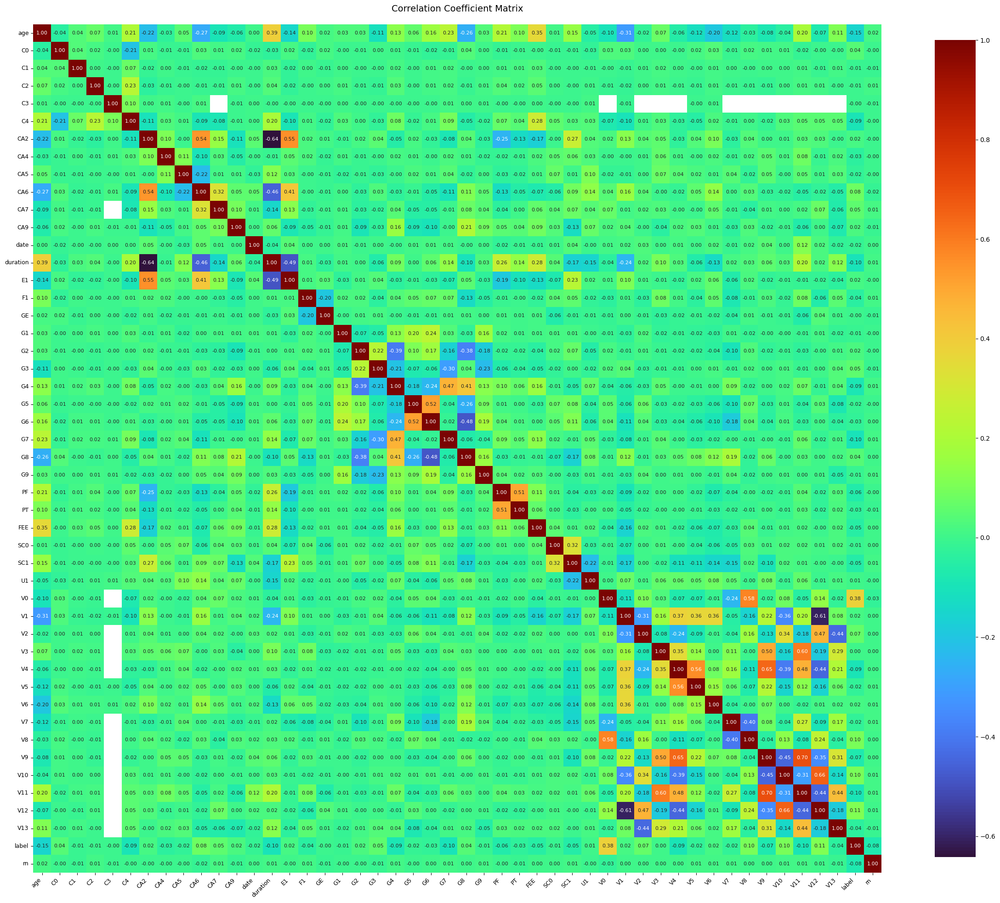

In [33]:
# ------------------------------------------------------------------
# Step 1: Define and drop unwanted columns if they exist
# ------------------------------------------------------------------
col_drop = ['index', 'CA1', 'CA3', 'CA8']  # Seeing certain columns don't feature and dropping them
df1 = df.drop(columns=[col for col in col_drop if col in df.columns])

# ------------------------------------------------------------------
# Step 2: Compute correlation matrix for remaining features
# ------------------------------------------------------------------
corr_matrix = df1.corr()

# ------------------------------------------------------------------
# Step 3: Dynamically determine figure width based on number of columns
# ------------------------------------------------------------------
col_number = len(corr_matrix.columns)
fig_width = max(12, col_number * 0.5)

# ------------------------------------------------------------------
# Step 4: Create heatmap of correlation coefficients
# ------------------------------------------------------------------
plt.figure(figsize=(fig_width, fig_width))  

sns.heatmap(
    corr_matrix,
    annot=True,              # show correlation values
    fmt=".2f",               # format to 2 decimal places
    cmap='turbo',            # use 'turbo' colormap (alternative: 'coolwarm')
    square=True,             # make cells square-shaped
    cbar_kws={"shrink": .75},# shrink color bar size
    annot_kws={"size": 8}    # annotation font size
)

# ------------------------------------------------------------------
# Step 5: Format ticks and labels for readability
# ------------------------------------------------------------------
plt.xticks(rotation=45, ha='right', fontsize=9)
plt.yticks(rotation=0, fontsize=9)
plt.title("Correlation Coefficient Matrix", fontsize=14, pad=20)
plt.show()


Notes: This initial heat map shows clusters of more prominent correlations 
- The Vx clusters show higher regions of correlation
- The Gx clusters show higher regions of correlation 
- The CAx clusters show higher regions of correlation

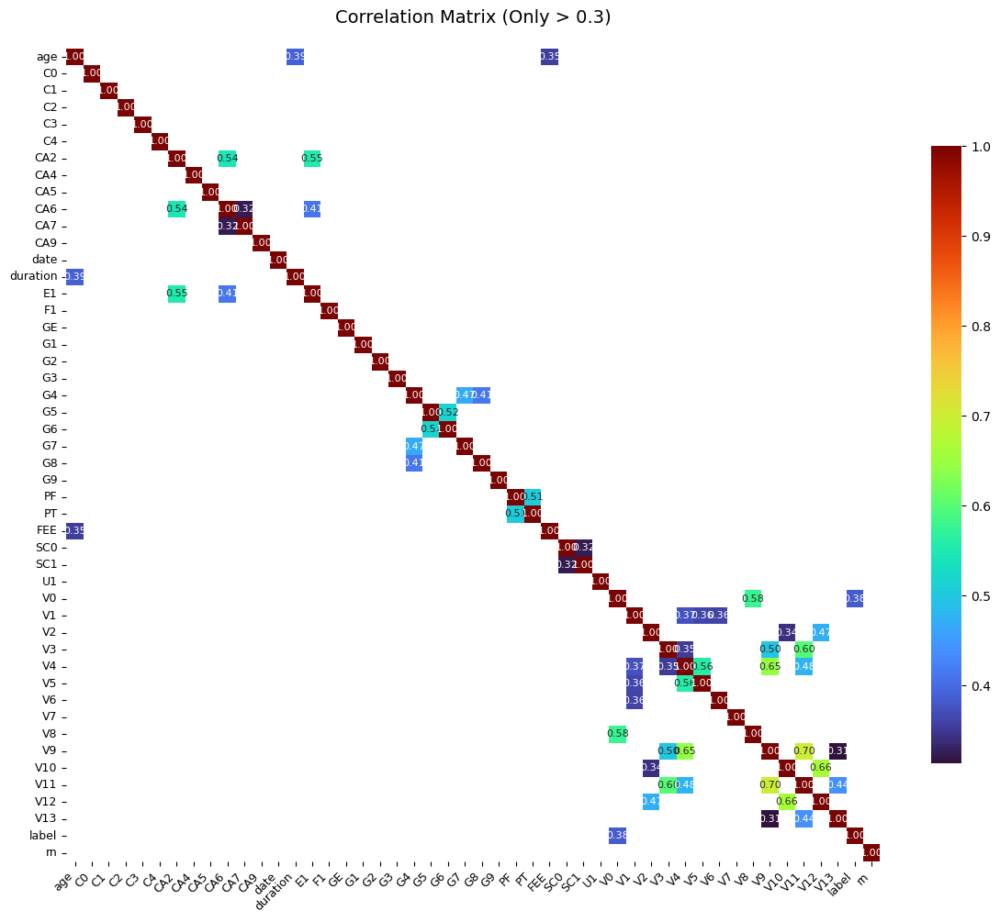

In [35]:
# ------------------------------------------------------------------
# Step 1: Compute full correlation matrix for filtered DataFrame
# ------------------------------------------------------------------
corr_matrix1 = df1.corr()

# ------------------------------------------------------------------
# Step 2: Filter matrix to retain only correlations > 0.3
# - Other values are replaced with NaN (masked in heatmap)
# ------------------------------------------------------------------
filtered_corr = corr_matrix1.where(corr_matrix1 > 0.3)  # refining the output to see columns with higher correlations

# ------------------------------------------------------------------
# Step 3: Plot heatmap of filtered correlations
# ------------------------------------------------------------------
plt.figure(figsize=(12, 10))
sns.heatmap(
    filtered_corr,
    annot=True,                  # show correlation values
    fmt=".2f",                   # two decimal places
    cmap='turbo',                # color palette
    square=True,                 # enforce square aspect ratio
    cbar_kws={"shrink": .75},    # shrink color bar
    annot_kws={"size": 8},       # font size for annotations
    mask=filtered_corr.isnull()  # hide cells with correlation ≤ 0.3
)

# ------------------------------------------------------------------
# Step 4: Format axis ticks and finalize layout
# ------------------------------------------------------------------
plt.xticks(rotation=45, ha='right', fontsize=9)
plt.yticks(rotation=0, fontsize=9)
plt.title("Correlation Matrix (Only > 0.3)", fontsize=14, pad=20)
plt.show()

In [37]:
# ------------------------------------------------------------------
# Step 1: Flatten the correlation matrix to get all pairwise combinations
# ------------------------------------------------------------------
corr_pairs = corr_matrix.unstack().reset_index()
corr_pairs.columns = ['Feature1', 'Feature2', 'Correlation']

# ------------------------------------------------------------------
# Step 2: Filter out self-correlations and keep only those with correlation > 0.3
# ------------------------------------------------------------------
high_corr_pairs = corr_pairs[
    (corr_pairs['Feature1'] != corr_pairs['Feature2']) &
    (corr_pairs['Correlation'] > 0.3)
]  # Filter out self-correlations and keep only those > 0.3

# ------------------------------------------------------------------
# Step 3: Sort by correlation value in descending order
# ------------------------------------------------------------------
high_corr_pairs_sort = high_corr_pairs.sort_values(by='Correlation', ascending=False)

# ------------------------------------------------------------------
# Step 4: Drop duplicate symmetric pairs (e.g., keep only one of (A,B) and (B,A))
# ------------------------------------------------------------------
high_corr_pairs_unique = high_corr_pairs_sort.drop_duplicates(subset=['Correlation'])

# ------------------------------------------------------------------
# Step 5: Display the final list of high-correlation feature pairs
# ------------------------------------------------------------------
print("Column pairs with correlation > 0.3:")
print(high_corr_pairs_unique)

Column pairs with correlation > 0.3:
     Feature1  Feature2  Correlation
2011       V9       V11     0.700122
2060      V10       V12     0.659887
1769       V4        V9     0.645585
2099      V11        V3     0.599847
1576       V0        V8     0.576859
1765       V4        V5     0.559527
302       CA2        E1     0.554390
438       CA6       CA2     0.543939
1030       G5        G6     0.515179
1275       PF        PT     0.505125
2003       V9        V3     0.497157
2100      V11        V4     0.478061
2146      V12        V2     0.472427
1124       G7        G4     0.468323
2109      V11       V13     0.440973
681        E1       CA6     0.411073
1172       G8        G4     0.410847
13        age  duration     0.388509
2240    label        V0     0.383057
1620       V1        V4     0.372320
1809       V5        V1     0.362731
1857       V6        V1     0.361149
28        age       FEE     0.353742
1763       V4        V3     0.352153
1674       V2       V10     0.340273
1

### > Variance Inflation Factor (Multicollinearity Check)

Reason for test: 

VIF let us spot and drop nearly-duplicate numeric features before feeding data to the tree ensemble. By removing high-VIF columns we:
- cut redundant splits → faster training / smaller forest,
- avoid two correlated features “competing,” which can blur feature importance,
- keep the tree’s decisions cleaner without interfering with predictive power.

In [35]:
# ------------------------------------------------------------------
# Step 1: Import VIF tools from statsmodels
# ------------------------------------------------------------------
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

# ------------------------------------------------------------------
# Step 2: Define target and VIF threshold
# ------------------------------------------------------------------
target   = 'label'   
vif_cut  = 5  # Red-flag threshold for multicollinearity

# ------------------------------------------------------------------
# Step 3: Select numeric features and remove target column
# ------------------------------------------------------------------
X = df.select_dtypes(include=[np.number]).drop(columns=[target], errors='ignore').copy()

# ------------------------------------------------------------------
# Step 4: Replace infinite values and impute missing values with median
# ------------------------------------------------------------------
X = X.replace([np.inf, -np.inf], np.nan)
X = X.apply(lambda col: col.fillna(col.median()), axis=0)

# ------------------------------------------------------------------
# Step 5: Drop constant columns (only one unique value)
# ------------------------------------------------------------------
const_cols = [c for c in X.columns if X[c].nunique(dropna=False) <= 1]
X = X.drop(columns=const_cols)

# ------------------------------------------------------------------
# Step 6: Add constant term for intercept in VIF calculation
# ------------------------------------------------------------------
X_const = sm.add_constant(X, has_constant='add')

# ------------------------------------------------------------------
# Step 7: Calculate VIF for each feature
# ------------------------------------------------------------------
vif_df  = pd.DataFrame({
    'Feature': X_const.columns,
    'VIF'    : [variance_inflation_factor(X_const.values, i)
                for i in range(X_const.shape[1])]
})

# ------------------------------------------------------------------
# Step 8: Drop constant term from results, flag high VIFs, and sort
# ------------------------------------------------------------------
vif_df = (vif_df[vif_df['Feature'] != 'const']
          .assign(High_VIF=lambda d: (d['VIF'] > vif_cut).astype(int))
          .sort_values('VIF', ascending=False))

# ------------------------------------------------------------------
# Step 9: Display final VIF table
# ------------------------------------------------------------------
display(vif_df)

,Feature,VIF,High_VIF
36,V4,2.548439,0
41,V9,2.406791,0
13,duration,2.269004,0
7,CA2,2.111464,0
24,G8,2.035090,0
43,V11,2.029310,0
22,G6,1.870786,0
20,G4,1.817401,0
1,age,1.668290,0
37,V5,1.627528,0


Notes:
- VIF > 5 is a problem - variance of regression coefficients inflated by neighbours (No VIF <=5)
- Linear models, highly overlapped predictors make coefficients unstable - in tree model they waste split depth

### > Data preprocessing before featue selection

In [43]:
# ------------------------------------------------------------------
# Step 1: Feature engineering — identify first record per group
# ------------------------------------------------------------------

df['is_first_record'] = (df['rn'] == 1).astype(int)  # Feature engineering on original df

# ------------------------------------------------------------------
# Step 2: Feature engineering — flag users with multiple records
# ------------------------------------------------------------------

df['has_multiple_records'] = (df.groupby('index')['index'].transform('count') > 1).astype(int) # is_first_record and has_multiple_records provide historical behavioral context.

# ------------------------------------------------------------------
# Step 3: Drop unnecessary or redundant columns
# ------------------------------------------------------------------

df_clean = df.drop(columns=['index', 'CA1', 'CA3', 'CA8', 'date'], errors='ignore')

# ------------------------------------------------------------------
# Step 4: Remove rows with any missing values
# ------------------------------------------------------------------

df_clean = df_clean.dropna()

# ------------------------------------------------------------------
# Step 5: Split into feature set (X) and target (y)
# ------------------------------------------------------------------

target = 'label'
X = df_clean.drop(columns=[target])
y = df_clean[target].astype(int)  # Ensure numeric target

### > Feature Selection Layer - Filter Layer 

Why: Feature selection keeps only the most informative columns, 
removing noise and redundancy so the tree learns faster, generalises better, and is easier to interpret.

In [45]:
# ------------------------------------------------------------------
# Step 1: Import mutual information feature selector
# ------------------------------------------------------------------

from sklearn.feature_selection import SelectKBest, mutual_info_classif

# ------------------------------------------------------------------
# Step 2: Apply SelectKBest using mutual information as the scoring function
# - k=10: select the 10 most informative features
# ------------------------------------------------------------------

selector = SelectKBest(score_func=mutual_info_classif, k=10)
X_selected = selector.fit_transform(X, y)

# ------------------------------------------------------------------
# Step 3: Retrieve and print names of selected features
# ------------------------------------------------------------------

selected_features = X.columns[selector.get_support()]  # Show selected features
print("Selected Features (Filter Layer):")
print(selected_features)

Selected Features (Filter Layer):
Index(['V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'rn', 'is_first_record',
       'has_multiple_records'],
      dtype='object')


### > Wrapper Layer - REF

Why: The RFE wrapper fits a model, removes the weakest feature each round, and stops when the remaining subset maximises performance, letting us keep features that work together, not just those that look beneficial to the model individually.

In [47]:
# ------------------------------------------------------------------
# Step 1: Import RFE and RandomForestClassifier for wrapper-based feature selection
# ------------------------------------------------------------------
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

# ------------------------------------------------------------------
# Step 2: Drop non-relevant columns and datetime columns
# ------------------------------------------------------------------
df_filtered = df.drop(columns=['index', 'CA1', 'CA3', 'CA8'], errors='ignore')
df_filtered = df_filtered.drop(columns=df_filtered.select_dtypes(include='datetime64').columns)

# ------------------------------------------------------------------
# Step 3: Check class distribution before handling missing values
# ------------------------------------------------------------------
class_counts = df_filtered['label'].value_counts()
print("Class distribution BEFORE dropna:\n", class_counts)  # Check class distribution before dropna

# ------------------------------------------------------------------
# Step 4: Perform stratified downsampling to balance classes before dropping NaNs
# ------------------------------------------------------------------
min_count = class_counts.min()
df_balanced = (
    df_filtered.groupby('label')
    .apply(lambda x: x.sample(n=min_count, random_state=42))
    .reset_index(drop=True)  # Balance classes before dropping NaNs
)

# ------------------------------------------------------------------
# Step 5: Drop missing values after balancing
# ------------------------------------------------------------------
df_balanced = df_balanced.dropna()

# ------------------------------------------------------------------
# Step 6: Define feature matrix X and target vector y
# ------------------------------------------------------------------
X = df_balanced.drop(columns=['label'])
y = df_balanced['label'].astype(int)

# ------------------------------------------------------------------
# Step 7: Fit RFE with Random Forest to select top 10 features
# ------------------------------------------------------------------
model = RandomForestClassifier(n_estimators=100, random_state=42)
rfe = RFE(model, n_features_to_select=10)
rfe.fit(X, y)

# ------------------------------------------------------------------
# Step 8: Retrieve and print selected feature names
# ------------------------------------------------------------------
selected_features = X.columns[rfe.support_]
print("Selected Features (Wrapper Layer):")
print(selected_features)

Class distribution BEFORE dropna:
 label
0    45000
1     5000
Name: count, dtype: int64


C:\Users\Natasha.Derrick\AppData\Local\Temp\ipykernel_45772\3823987665.py:13: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=min_count, random_state=42))


Selected Features (Wrapper Layer):
Index(['V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'rn', 'is_first_record',
       'has_multiple_records'],
      dtype='object')


### > Filter Layer - Select KBest with Mutual Info

Why: The filter layer (SelectKBest with mutual info) quickly scores each feature’s individual relevance to the target, helping eliminate obvious noise before model training.

In [48]:
# ------------------------------------------------------------------
# Step 1: (Optional) Apply SelectKBest — commented out test code
# ------------------------------------------------------------------
# selector = SelectKBest(score_func=mutual_info_classif, k=10)  # Apply SelectKBest
# X_selected = selector.fit_transform(X, y)

# selected_features = X.columns[selector.get_support()]
# print("Selected Features (Filter Layer):")
# print(selected_features)

# ------------------------------------------------------------------
# Step 2: Import SelectKBest and mutual_info_classif
# ------------------------------------------------------------------
from sklearn.feature_selection import SelectKBest, mutual_info_classif

# ------------------------------------------------------------------
# Step 3: Drop irrelevant columns and rows with missing values
# ------------------------------------------------------------------
df_clean = df.drop(columns=['index', 'CA1', 'CA3', 'CA8', 'date'], errors='ignore')
df_clean = df_clean.dropna()

# ------------------------------------------------------------------
# Step 4: Define feature matrix (X) and target variable (y)
# ------------------------------------------------------------------
X = df_clean.drop(columns=['label'])
y = df_clean['label'].astype(int)

# ------------------------------------------------------------------
# Step 5: Apply SelectKBest using mutual information to select top 10 features
# ------------------------------------------------------------------
selector = SelectKBest(score_func=mutual_info_classif, k=10) 
X_selected = selector.fit_transform(X, y)

# ------------------------------------------------------------------
# Step 6: Display names of selected features
# ------------------------------------------------------------------
selected_features = X.columns[selector.get_support()]
print("Selected Features (Filter Layer):")
print(selected_features)


Selected Features (Filter Layer):
Index(['V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'rn', 'is_first_record',
       'has_multiple_records'],
      dtype='object')


### > Random Forest Policy Cancellation Pipeline

Why: 
- Robust to noise and overfitting due to ensemble averaging.
- Handles non-linear relationships well - relevant for this dataset
- Automatically ranks feature importance.
- Works with imbalanced datasets using class weights or sampling - relevant for this dataset

Label balance before sampling:
 label
0    45000
1     5000
Name: count, dtype: int64
Label balance after undersampling:
 label
0    5000
1    5000
Name: count, dtype: int64
Best hyper-parameters: {'n_estimators': 1000, 'min_samples_leaf': 5, 'max_features': 0.3, 'max_depth': None}
Cross-validated ROC-AUC: 0.771

Test-set metrics
Accuracy : 0.682
Precision: 0.688
Recall   : 0.666
F1-score : 0.677
ROC-AUC  : 0.754
PR-AUC   : 0.766


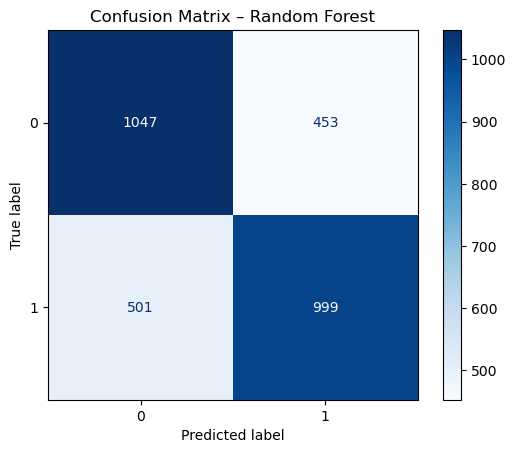

C:\Users\Natasha.Derrick\AppData\Local\Temp\ipykernel_45772\957382583.py:99: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=fi.values, y=fi.index, palette='viridis')


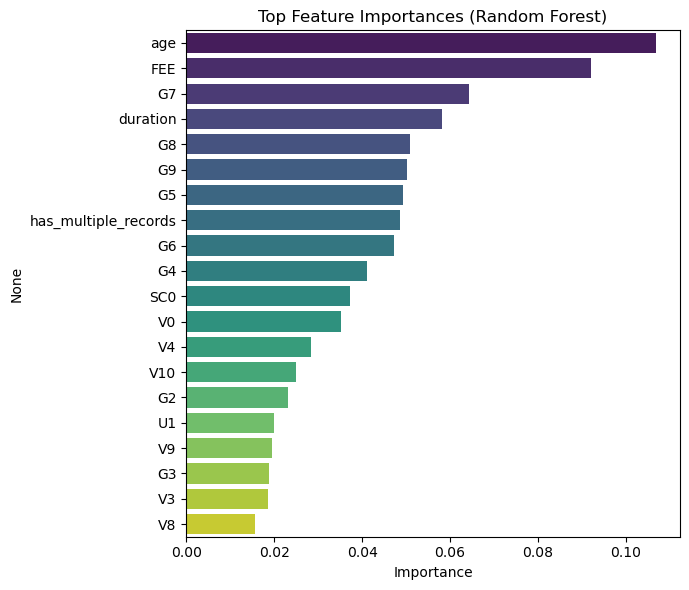

In [55]:
# ------------------------------------------------------------------
# Step 1: Import required libraries for modeling, preprocessing, and visualization
# ------------------------------------------------------------------
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, roc_auc_score, average_precision_score,
                             ConfusionMatrixDisplay)
from sklearn.impute import SimpleImputer
from imblearn.under_sampling import RandomUnderSampler
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------------------------------------------
# Step 2: Create working copy of the data
# ------------------------------------------------------------------
df_work = df.copy() 

# ------------------------------------------------------------------
# Step 3: Optional conversion of label from boolean to integer - uncomment to run cell in isolation without executing previous cells
# ------------------------------------------------------------------
# if 'label' in df_work.columns:
#     df_work['label'] = (
#         df_work['label']
#         .map({False: 0, True: 1})        # convert booleans
#         .astype(int)                     # make sure dtype is int
#     )

# ------------------------------------------------------------------
# Step 4: Handle index column and assign user_id
# ------------------------------------------------------------------
if 'index' in df_work.columns:
    df_work = df_work.rename(columns={'index': 'user_id'})
else:
    df_work['user_id'] = df_work.index

# ------------------------------------------------------------------
# Step 5: Generate row number (rn) for historical feature context
# ------------------------------------------------------------------
if 'rn' not in df_work.columns:
    df_work = df_work.sort_values(['user_id'])
    df_work['rn'] = df_work.groupby('user_id').cumcount() + 1

# ------------------------------------------------------------------
# Step 6: Feature engineering — flags for first record and duplicates
# ------------------------------------------------------------------
df_work['is_first_record'] = (df_work['rn'] == 1).astype(int)
df_work['has_multiple_records'] = (
    df_work.groupby('user_id')['user_id'].transform('count') > 1
).astype(int)

# ------------------------------------------------------------------
# Step 7: Extract first and second records for duplicate users (optional review)
# ------------------------------------------------------------------
dup_keys = df_work['user_id'].value_counts().loc[lambda s: s >= 2].index
df_dups  = (df_work[df_work['user_id'].isin(dup_keys) & df_work['rn'].isin([1, 2])]
            .sort_values(['user_id', 'rn']))

# ------------------------------------------------------------------
# Step 8: Re-apply flags for completeness
# ------------------------------------------------------------------
df_work['is_first_record'] = (df_work['rn'] == 1).astype(int)
df_work['has_multiple_records'] = (
    df_work.groupby('user_id')['user_id'].transform('count') > 1
).astype(int)

# ------------------------------------------------------------------
# Step 9: Drop unnecessary columns
# ------------------------------------------------------------------
drop_cols = ['user_id', 'CA1', 'CA3', 'CA8', 'date']
df_work = df_work.drop(columns=[c for c in drop_cols if c in df_work.columns],
                       errors='ignore')

# ------------------------------------------------------------------
# Step 10: Split features and target
# ------------------------------------------------------------------
X = df_work.drop(columns=['label'])
y = df_work['label'].astype(int)
print('Label balance before sampling:\n', y.value_counts())

# ------------------------------------------------------------------
# Step 11: Apply random undersampling to balance the classes
# ------------------------------------------------------------------
rus = RandomUnderSampler(random_state=42)
X_bal, y_bal = rus.fit_resample(X, y)
print('Label balance after undersampling:\n', pd.Series(y_bal).value_counts())

# ------------------------------------------------------------------
# Step 12: Median imputation of missing values
# ------------------------------------------------------------------
imp = SimpleImputer(strategy='median')
X_bal = pd.DataFrame(imp.fit_transform(X_bal), columns=X.columns)

# ------------------------------------------------------------------
# Step 13: Train-test split (stratified)
# ------------------------------------------------------------------
X_tr, X_te, y_tr, y_te = train_test_split(
    X_bal, y_bal, test_size=0.30, stratify=y_bal, random_state=42
)

# ------------------------------------------------------------------
# Step 14: Define Random Forest and hyperparameter grid
# ------------------------------------------------------------------
rf = RandomForestClassifier(random_state=42, class_weight='balanced')
param_grid = {
    'n_estimators':     [300, 500, 800, 1000],
    'max_depth':        [None, 6, 12],
    'min_samples_leaf': [1, 3, 5, 10],
    'max_features':     ['sqrt', 0.3, 0.5],
}

# ------------------------------------------------------------------
# Step 15: Run randomized search with cross-validation
# ------------------------------------------------------------------
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
search = RandomizedSearchCV(
    rf, param_grid, n_iter=20, scoring='roc_auc',
    cv=cv, n_jobs=-1, random_state=42
).fit(X_tr, y_tr)

# ------------------------------------------------------------------
# Step 16: Output best model and CV performance
# ------------------------------------------------------------------
best_rf = search.best_estimator_
print('Best hyper-parameters:', search.best_params_)
print('Cross-validated ROC-AUC:', round(search.best_score_, 3))

# ------------------------------------------------------------------
# Step 17: Evaluate on test set
# ------------------------------------------------------------------
y_pred = best_rf.predict(X_te)
y_prob = best_rf.predict_proba(X_te)[:, 1]

print('\nTest-set metrics')
print('Accuracy :', round(accuracy_score(y_te, y_pred), 3))
print('Precision:', round(precision_score(y_te, y_pred), 3))
print('Recall   :', round(recall_score(y_te, y_pred), 3))
print('F1-score :', round(f1_score(y_te, y_pred), 3))
print('ROC-AUC  :', round(roc_auc_score(y_te, y_prob), 3))
print('PR-AUC   :', round(average_precision_score(y_te, y_prob), 3))

# ------------------------------------------------------------------
# Step 18: Display confusion matrix
# ------------------------------------------------------------------
ConfusionMatrixDisplay.from_predictions(y_te, y_pred, cmap='Blues')
plt.title('Confusion Matrix – Random Forest')
plt.show()

# ------------------------------------------------------------------
# Step 19: Plot top 20 feature importances
# ------------------------------------------------------------------
fi = (pd.Series(best_rf.feature_importances_, index=X.columns)
        .sort_values(ascending=False)[:20])
plt.figure(figsize=(7, 6))
sns.barplot(x=fi.values, y=fi.index, palette='viridis')
plt.title('Top Feature Importances (Random Forest)')
plt.xlabel('Importance')
plt.show()

### > XG Boost Policy Cancellation Predictive Model (Iteration 1)

Why:
- More accurate and faster than most tree-based models due to optimized boosting.
- Good with handling non-linear patterns and complex interactions.
- Includes regularization to reduce overfitting (a problem to avoid).
- Works well on imbalanced data and supports parallel computation.

Fitting 5 folds for each of 30 candidates, totalling 150 fits


C:\Users\Natasha.Derrick\AppData\Local\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [13:54:03] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best params: {'subsample': 0.7, 'n_estimators': 300, 'min_child_weight': 1, 'max_depth': 4, 'learning_rate': 0.03, 'gamma': 0.3, 'colsample_bytree': 1.0}
CV ROC-AUC  : 0.781

Test metrics
Accuracy : 0.7
Precision: 0.706
Recall   : 0.685
F1-score : 0.696
ROC-AUC  : 0.768
PR-AUC   : 0.781


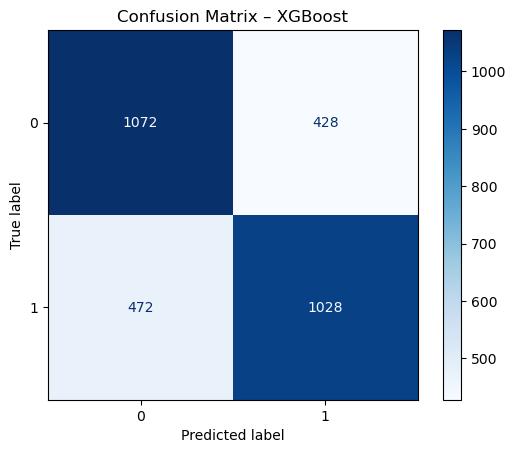

C:\Users\Natasha.Derrick\AppData\Local\Temp\ipykernel_1904\2277492900.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances.values, y=importances.index, palette='magma')


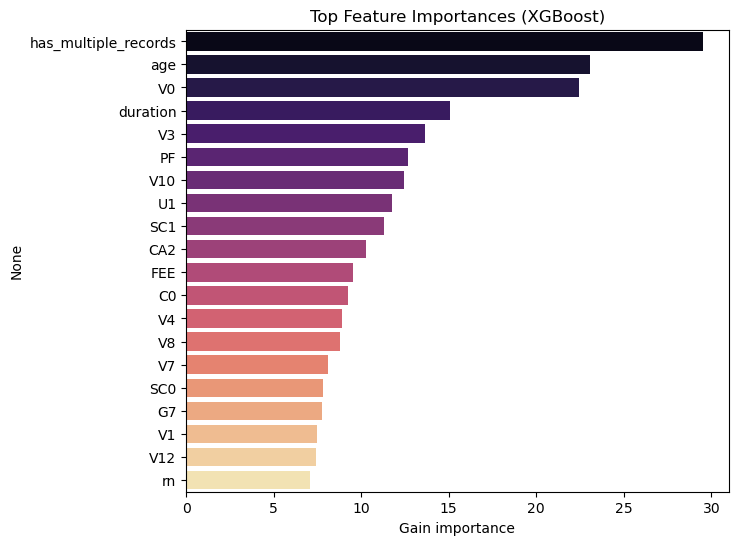

,Actual,Predicted
13388,1,1
22681,1,0
29074,0,0
23604,1,0
29485,1,0
...,...,...
17070,0,0
41093,1,0
48774,0,0
14419,1,1


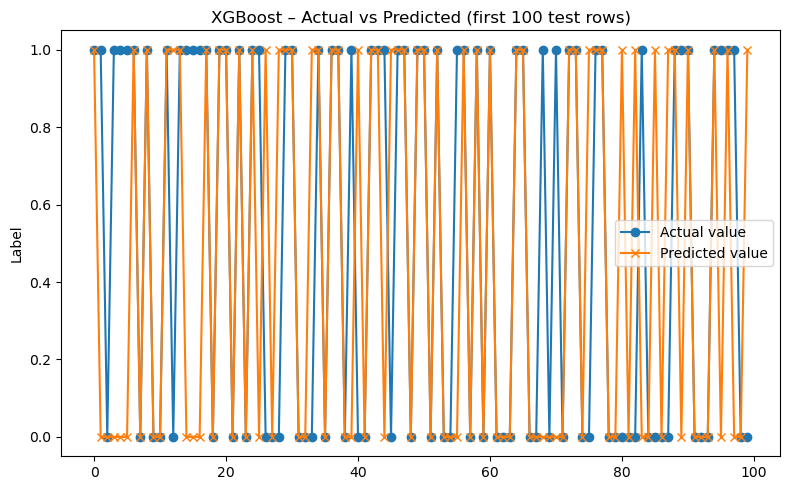

In [79]:
import pandas as pd, numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, roc_auc_score, average_precision_score,
                             ConfusionMatrixDisplay)
from sklearn.impute import SimpleImputer
from imblearn.under_sampling import RandomUnderSampler
from xgboost import XGBClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------------------------------------------
# Step 1: Copy of raw data  &  label mapping (only required if executing cell without previous cells)
# ------------------------------------------------------------------
df_work = df.copy()

if 'index' in df_work.columns:
    df_work = df_work.rename(columns={'index': 'user_id'})
else:
    df_work['user_id'] = df_work.index

#if df_work['label'].dtype != int:
#    df_work['label'] = df_work['label'].map({False: 0, True: 1}).astype(int) #uncomment if running cell in isolation to transform t/f into 1/0

# ------------------------------------------------------------------
# Step 2: row number + historical flag logic addition to use as features
# ------------------------------------------------------------------
if 'rn' not in df_work.columns:
    df_work = df_work.sort_values(['user_id'])
    df_work['rn'] = df_work.groupby('user_id').cumcount() + 1

df_work['is_first_record']      = (df_work['rn'] == 1).astype(int)
df_work['has_multiple_records'] = (
    df_work.groupby('user_id')['user_id'].transform('count') > 1
).astype(int)

drop_cols = ['user_id', 'CA1', 'CA3', 'CA8', 'date']
df_work = df_work.drop(columns=[c for c in drop_cols if c in df_work.columns],
                       errors='ignore')

# ------------------------------------------------------------------
# Step 3:  Build X / y, under-sample majority, median-impute for nan
# ------------------------------------------------------------------
X = df_work.drop(columns=['label'])
y = df_work['label']

rus = RandomUnderSampler(random_state=42)
X_bal, y_bal = rus.fit_resample(X, y)

X_bal = pd.DataFrame(SimpleImputer(strategy='median')
                     .fit_transform(X_bal), columns=X.columns)

X_tr, X_te, y_tr, y_te = train_test_split(
    X_bal, y_bal, test_size=0.30, stratify=y_bal, random_state=42
)

# ------------------------------------------------------------------
# Step 4: Hyper-parameter search for XGBoost
# ------------------------------------------------------------------
xgb = XGBClassifier(
    objective='binary:logistic',
    eval_metric='auc',
    use_label_encoder=False,
    random_state=42,
    n_jobs=-1
)

param_grid = {
    'n_estimators':   [300, 500, 800, 1000],
    'max_depth':      [4, 6, 8],
    'learning_rate':  [0.03, 0.05, 0.1],
    'subsample':      [0.7, 0.9, 1.0],
    'colsample_bytree':[0.5, 0.7, 1.0],
    'min_child_weight':[1, 3, 5],
    'gamma':          [0, 0.1, 0.3]
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
search = RandomizedSearchCV(
    xgb, param_grid, n_iter=30, scoring='roc_auc',
    cv=cv, verbose=1, random_state=42, n_jobs=-1
).fit(X_tr, y_tr)

best_xgb = search.best_estimator_
print('Best params:', search.best_params_)
print('CV ROC-AUC  :', round(search.best_score_, 3))

# ------------------------------------------------------------------
# Step 5:  Test-set evaluation
# ------------------------------------------------------------------
y_pred = best_xgb.predict(X_te)
y_prob = best_xgb.predict_proba(X_te)[:, 1]

print('\nTest metrics')
print('Accuracy :', round(accuracy_score(y_te, y_pred), 3))
print('Precision:', round(precision_score(y_te, y_pred), 3))
print('Recall   :', round(recall_score(y_te, y_pred), 3))
print('F1-score :', round(f1_score(y_te, y_pred), 3))
print('ROC-AUC  :', round(roc_auc_score(y_te, y_prob), 3))
print('PR-AUC   :', round(average_precision_score(y_te, y_prob), 3))

ConfusionMatrixDisplay.from_predictions(y_te, y_pred, cmap='Blues')
plt.title('Confusion Matrix – XGBoost')
plt.show()

# ------------------------------------------------------------------
# Step 6: Top-20 SHAP-style importances (gain)
# ------------------------------------------------------------------
importances = pd.Series(best_xgb.get_booster().get_score(importance_type='gain'))
importances = importances.sort_values(ascending=False)[:20]

plt.figure(figsize=(7, 6))
sns.barplot(x=importances.values, y=importances.index, palette='magma')
plt.title('Top Feature Importances (XGBoost)')
plt.xlabel('Gain importance')
plt.show()

# ------------------------------------------------------------------
# Step 7: Predicted-vs-Actual table and line-plot
# ------------------------------------------------------------------
xgb_pred_test_df = pd.DataFrame({'Actual': y_te, 'Predicted': y_pred})

# display the full table if desired
display(xgb_pred_test_df)

# simple line plot of the first 50 observations
fig = plt.figure(figsize=(8, 5))
tmp = xgb_pred_test_df.reset_index(drop=True).iloc[:100]   # keep order, drop old index
plt.plot(tmp['Actual'], marker='o')
plt.plot(tmp['Predicted'], marker='x')
plt.title('XGBoost – Actual vs Predicted (first 100 test rows)')
plt.ylabel('Label')
plt.legend(['Actual value', 'Predicted value'])
plt.tight_layout()
plt.show()


### > XG Boost Policy Cancellation Predictive Model (Iteration 2 using SMOTE)

Reason for redoing XG Boost: I was not satisfied with the accuracy score

Fitting 5 folds for each of 30 candidates, totalling 150 fits


C:\Users\Natasha.Derrick\AppData\Local\anaconda3\Lib\site-packages\xgboost\core.py:158: UserWarning: [14:26:27] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best params: {'subsample': 0.9, 'n_estimators': 300, 'min_child_weight': 5, 'max_depth': 8, 'learning_rate': 0.03, 'gamma': 0.1, 'colsample_bytree': 0.7}
CV ROC-AUC  : 0.977

Test metrics
Accuracy : 0.947
Precision: 0.989
Recall   : 0.904
F1-score : 0.945
ROC-AUC  : 0.977
PR-AUC   : 0.983


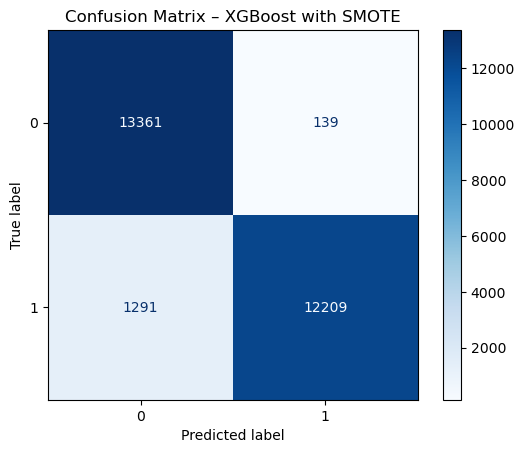

C:\Users\Natasha.Derrick\AppData\Local\Temp\ipykernel_1904\1130608481.py:110: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances.values, y=importances.index, palette='magma')


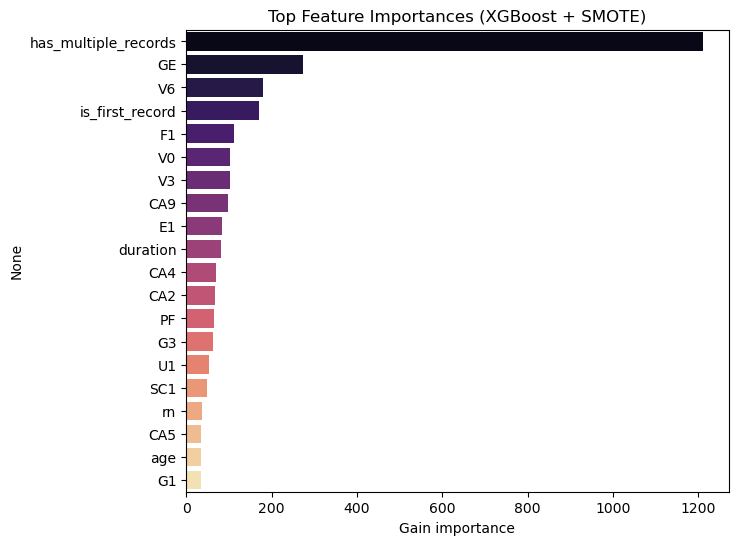

In [82]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold, RandomizedSearchCV
from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, roc_auc_score, average_precision_score,
                             ConfusionMatrixDisplay)
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------------------------------------------
# Step 1: Data Preparation
# ------------------------------------------------------------------
df_work = df.copy()

if 'index' in df_work.columns:
    df_work = df_work.rename(columns={'index': 'user_id'})
else:
    df_work['user_id'] = df_work.index

# df_work['label'] = df_work['label'].map({False: 0, True: 1}).astype(int)

if 'rn' not in df_work.columns:
    df_work = df_work.sort_values(['user_id'])
    df_work['rn'] = df_work.groupby('user_id').cumcount() + 1

df_work['is_first_record'] = (df_work['rn'] == 1).astype(int)
df_work['has_multiple_records'] = (
    df_work.groupby('user_id')['user_id'].transform('count') > 1
).astype(int)

drop_cols = ['user_id', 'CA1', 'CA3', 'CA8', 'date']
df_work = df_work.drop(columns=[c for c in drop_cols if c in df_work.columns], errors='ignore')

X = df_work.drop(columns=['label'])
y = df_work['label'].astype(int)

# ------------------------------------------------------------------
# Step 2: Apply SMOTE
# ------------------------------------------------------------------
X = pd.DataFrame(SimpleImputer(strategy='median').fit_transform(X), columns=X.columns)
sm = SMOTE(random_state=42)
X_bal, y_bal = sm.fit_resample(X, y)

# ------------------------------------------------------------------
# Step 3: Train-Test Split
# ------------------------------------------------------------------
X_tr, X_te, y_tr, y_te = train_test_split(
    X_bal, y_bal, test_size=0.30, stratify=y_bal, random_state=42
)

# ------------------------------------------------------------------
# Step 4: XGBoost Model & Hyperparameter Tuning
# ------------------------------------------------------------------
xgb = XGBClassifier(
    objective='binary:logistic',
    eval_metric='auc',
    #use_label_encoder=False, #gives warning so commented out
    random_state=42,
    n_jobs=-1
)

param_grid = {
    'n_estimators':   [300, 500, 800, 1000],
    'max_depth':      [4, 6, 8],
    'learning_rate':  [0.03, 0.05, 0.1],
    'subsample':      [0.7, 0.9, 1.0],
    'colsample_bytree':[0.5, 0.7, 1.0],
    'min_child_weight':[1, 3, 5],
    'gamma':          [0, 0.1, 0.3]
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
search = RandomizedSearchCV(
    xgb, param_grid, n_iter=30, scoring='roc_auc',
    cv=cv, verbose=1, random_state=42, n_jobs=-1
).fit(X_tr, y_tr)

best_xgb = search.best_estimator_
print('Best params:', search.best_params_)
print('CV ROC-AUC  :', round(search.best_score_, 3))

# ------------------------------------------------------------------
# Step 5: Evaluation
# ------------------------------------------------------------------
y_pred = best_xgb.predict(X_te)
y_prob = best_xgb.predict_proba(X_te)[:, 1]

print('\nTest metrics')
print('Accuracy :', round(accuracy_score(y_te, y_pred), 3))
print('Precision:', round(precision_score(y_te, y_pred), 3))
print('Recall   :', round(recall_score(y_te, y_pred), 3))
print('F1-score :', round(f1_score(y_te, y_pred), 3))
print('ROC-AUC  :', round(roc_auc_score(y_te, y_prob), 3))
print('PR-AUC   :', round(average_precision_score(y_te, y_prob), 3))

ConfusionMatrixDisplay.from_predictions(y_te, y_pred, cmap='Blues')
plt.title('Confusion Matrix – XGBoost with SMOTE')
plt.show()

# ------------------------------------------------------------------
# Step 6: Feature Importances
# ------------------------------------------------------------------
importances = pd.Series(best_xgb.get_booster().get_score(importance_type='gain'))
importances = importances.sort_values(ascending=False)[:20]

plt.figure(figsize=(7, 6))
sns.barplot(x=importances.values, y=importances.index, palette='magma')
plt.title('Top Feature Importances (XGBoost + SMOTE)')
plt.xlabel('Gain importance')
plt.show()


Marketing Recommendations:

A marketing campaign to improve retention rates is planned.  

•	Based on your insights from this dataset and your previous analysis, which customers would you focus on and why?

•	What kinds of interventions could you use to target these customers?

•	What kind of issues would you need to consider in implementing such a campaign using these results?

Age – Customers under 30 and within the agegroup between 30-39 carry the steepest positive SHAP values, meaning the model “pushes” their predicted probability of cancellation upward. 
Industry benchmarks agree: younger customers shop rates aggressively and switch for small price deltas

Policy duration – SHAP impact is strongly positive in months 0–11, flips negative after the first anniversary and keeps falling thereafter. 
Actuarial studies put first-year lapses at up to 30–50 %, then dropping sharply in years 2-3. 
Duration bins: 0-3 months comprise 22% of the total churn, with 4-11 months comprising 21%, these relative risks are the highest when comparing to the baseline.
A recommendation for this first-year group could be a no-claim for the first 9 month reward. The intention of this recommendation is to reduce the first
bin of 0-3 months which comprise 22% of policy cancellations. 
    
There are several Gx columns, likely geographic by my assumption that feature in the models and have a certain notable gain. I would recommend a focused
campaign associated with these geographic regions.

It appears that individuals with multiple records, likely either changing their policy or having multiple claims also tend to feature in the gain, it 
has the highest relative gain. There are studies that have shown that people with multiple claims (assuming it may be the reason for the multiple records)
have a higher probability of churning. 
The next recommendation is also based on an assumption:
- any policy-holder whose churn probability ≥ 0.90 and who logged a second claim or service ticket in 90 days. Let this act as a trigger. 
- CRM automatically opens a same-day callback task for an agent authorised to (1) fast-track the claim, (2) waive one excess fee, or (3) offer a one-month premium break.
- I read an academic paper that mentioned poor claims experiences alone could jeopardise one in six premiums; turning a bad moment into a concierge-style rescue can halve churn in that cohort.

I would propose a strategy targeting the agegroups abovementioned along with higher focus on individuals within their first year of their policy activation,
incentivized programmes already exist at Discovery, so perhaps additional flags and focus on these groups could be more beneficial. 
